In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
# Model Inversion Approach
Raphael Beyweiss  
Schafellner Jakob  
Quotschalla Maurice  

In [2]:
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior() 

import numpy as np

import os 
import sys
from PIL import Image
from sys import stdout
from scipy import linalg

from keras.preprocessing.image import ImageDataGenerator

from sklearn.base import TransformerMixin, BaseEstimator
from sklearn.utils.validation import check_is_fitted
from sklearn.utils import check_array, as_float_array


Instructions for updating:
non-resource variables are not supported in the long term


Using TensorFlow backend.


In [0]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from mpl_toolkits.axes_grid1 import ImageGrid

## Other stuff we used

We used __Global Contrast Optimization__ and __ZCA__. This helps to preserve the facial features present in the input dataset.

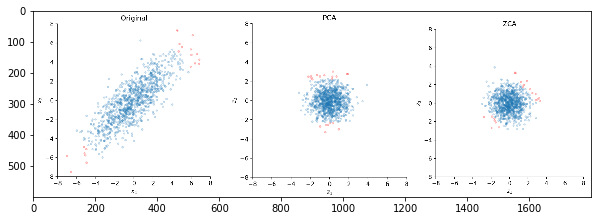

In [4]:
## Original vs. PCA. vs. ZCA
## ZCA does an additional rotation

plt.figure(figsize=(10,5))
img=mpimg.imread('/content/drive/My Drive/Colab Notebooks/images/combined.jpg')
imgplot = plt.imshow(img)
plt.show()

## Dataset

We used the famous ORL-Dataset which was also mentioned in the linked paper of this assignment.  
This dataset consits images from 40 different persons.  
Each person is shown on 10 pictures.

This makes __400__ images in total.

Soure: https://www.kaggle.com/kasikrit/att-database-of-faces

In [0]:
data_path = '/content/drive/My Drive/Colab Notebooks/data/att-database-of-faces/'
data_path_zca = '/content/drive/My Drive/Colab Notebooks/data/yalefaces/'

In [0]:
def global_contrast_normalize(data, scale=1, lmda=10, epsilon=0.000000001):
    X = np.array(data)
    
    X_average = np.mean(X)
    ##print('Mean: ', X_average)
    X = X - X_average

    contrast = np.sqrt(lmda + np.mean(X**2))
    X = scale * X / max(contrast, epsilon)
    return X

In [0]:
class ZCA(BaseEstimator, TransformerMixin):
    def __init__(self, regularization=1e-6, copy=False):
        self.regularization = regularization
        self.copy = copy

    def fit(self, X, y=None):
        """Compute the mean, whitening and dewhitening matrices.
        Parameters
        ----------
        X : array-like with shape [n_samples, n_features]
            The data used to compute the mean, whitening and dewhitening
            matrices.
        """
        X = check_array(X, accept_sparse=None, copy=self.copy,
                        ensure_2d=True)
        X = as_float_array(X, copy=self.copy)
        self.mean_ = X.mean(axis=0)
        X_ = X - self.mean_
        cov = np.dot(X_.T, X_) / (X_.shape[0]-1)
        U, S, _ = linalg.svd(cov)
        s = np.sqrt(S.clip(self.regularization))
        s_inv = np.diag(1./s)
        s = np.diag(s)
        self.whiten_ = np.dot(np.dot(U, s_inv), U.T)
        self.dewhiten_ = np.dot(np.dot(U, s), U.T)
        return self

    def transform(self, X, y=None, copy=None):
        """Perform ZCA whitening
        Parameters
        ----------
        X : array-like with shape [n_samples, n_features]
            The data to whiten along the features axis.
        """
        check_is_fitted(self, 'mean_')
        X = as_float_array(X, copy=self.copy)
        return np.dot(X - self.mean_, self.whiten_.T)

    def inverse_transform(self, X, copy=None):
        """Undo the ZCA transform and rotate back to the original
        representation
        Parameters
        ----------
        X : array-like with shape [n_samples, n_features]
            The data to rotate back.
        """
        check_is_fitted(self, 'mean_')
        X = as_float_array(X, copy=self.copy)
        return np.dot(X, self.dewhiten_) + self.mean_

In [0]:
def weight_variable(shape):
    initial = tf.truncated_normal(shape=shape, stddev=0.1)
    return tf.Variable(initial)

def bias_variable(shape):
    initial = tf.constant(0.1, shape=shape)
    return tf.Variable(initial)

def face_imshow(myplt, img, correct_predicted=True):
    myplt.axis('off')
    if correct_predicted:
      myplt.imshow(img.reshape([112,92]), cmap="gray")
    else:
      myplt.imshow(img.reshape([112,92]), cmap="RdGy")
    

def one_hot_preds(preds):
    t = np.argmax(preds, axis=1)
    r = np.zeros(preds.shape)
    for i in range(t.shape[0]):
        r[i,t[i]] = 1
    return r

def one_hot_class(a):
    b = np.zeros((len(a), np.max(a).astype(int)+1), np.float32)
    b[np.arange(len(a)), a.astype(int)] = 1
    return b

In [0]:
def load_data(path = data_path, sz=(112, 92)):
    train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.3)

    # 70% train data = 280 images
    train_generator = train_datagen.flow_from_directory(
      path,
      color_mode='grayscale',
      target_size=sz,
      batch_size=280,
      class_mode='categorical',
      subset='training')


    # 30% test data = 120 images
    test_generator = train_datagen.flow_from_directory(
        path,
        color_mode='grayscale',
        target_size=sz,
        batch_size=120,
        class_mode='categorical',
        subset='validation')
    
    (x_train, y_train) = next(train_generator)
    (x_test, y_test) = next(test_generator)
    return x_train.reshape((-1,sz[0]*sz[1])), x_test.reshape((-1,sz[0]*sz[1])), y_train, y_test

In [0]:
def load_data_zca(path = data_path_zca, sz=(112, 92), zoom = [1,1]):
    train_datagen_zca = ImageDataGenerator(rescale=1./255, validation_split=0, zoom_range=zoom)

    # 4 images for 15 individuals = 60
    train_generator_zca = train_datagen_zca.flow_from_directory(
      path,
      color_mode='grayscale',
      target_size=sz,
      batch_size=60,
      class_mode='categorical',
      subset='training')
    
    (x_train, y_train) = next(train_generator_zca)
    return x_train.reshape((-1,sz[0]*sz[1])), y_train

In [0]:
def normalize(img, prep, img_shape):
    
    img = global_contrast_normalize(img.reshape(1, -1) * 255, scale=55.)
    img = prep.inverse_transform(img.reshape(1, -1))[0]
    img /= np.abs(img).max()
    img = np.clip(img, -1., 1.)
    img = (img + 1.) / 2.
    img = prep.transform(img)
    return img.reshape(img_shape)

def post_process(img, prep, img_shape):
    # normalize without contrast_normalize and mean_subtract
    img = prep.inverse_transform(img.reshape(1, -1))[0]
    img /= np.abs(img).max()
    img = np.clip(img, -1., 1.)
    img = (img + 1.) / 2.
    return img.reshape(img_shape)

In [11]:
train_x, test_x, train_y, test_y  = load_data(data_path) # 70/30 Train/validate split 

Found 280 images belonging to 40 classes.
Found 120 images belonging to 40 classes.


In [123]:
train_zca_x, train_zca_y = load_data_zca(data_path_zca) # should be 60 images
train_zca_zoom_x, train_zca_zoom_y = load_data_zca(data_path_zca, zoom=[0.75,0.75]) # should be 60 images zoomed

Found 60 images belonging to 15 classes.
Found 60 images belonging to 15 classes.


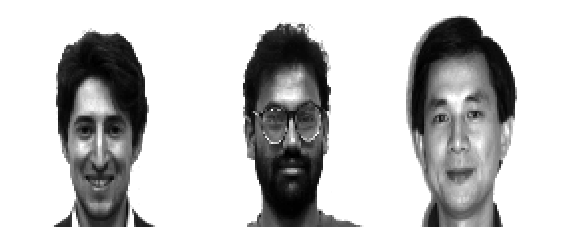

In [124]:
fig = plt.figure(1, figsize=(10, 5))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
          nrows_ncols=(1, 3),  # creates grid of axes
          axes_pad=0.1,  # pad between axes in inch.
          )
for img, gri in zip(train_zca_x[0:3], grid):
  face_imshow(gri, img)

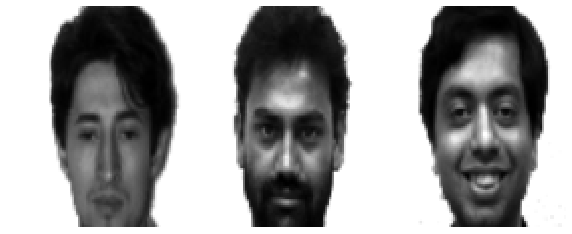

In [125]:
fig = plt.figure(1, figsize=(10, 5))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
          nrows_ncols=(1, 3),  # creates grid of axes
          axes_pad=0.1,  # pad between axes in inch.
          )
for img, gri in zip(train_zca_zoom_x[0:3], grid):
  face_imshow(gri, img)

In [0]:
class Model:
    def __init__(self, x, y_):

        in_dim = int(x.get_shape()[1]) # 10304 for Face dataset
        out_dim = int(y_.get_shape()[1]) # 40 for Face dataset
        self.x = x
        # switiching to a simple 2-layer network with relu
        W = weight_variable([in_dim,out_dim])
        b = bias_variable([out_dim])
        self.y = tf.matmul(x,W) + b # output layer
        self.probs = tf.nn.softmax(self.y)
        self.class_inds = tf.argmax(self.probs,1)
        self.cross_entropy = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits_v2(labels=y_, logits=self.y))
        
        class_ind_correct = tf.argmax(y_,1)
        self.class_prob = (self.probs[0, tf.cast(class_ind_correct[0],tf.int32)])
        self.loss = tf.subtract(tf.constant(1.0), self.class_prob )
        
        self.grads = tf.gradients(self.cross_entropy, x)
        
        self.train_step = tf.train.GradientDescentOptimizer(0.1).minimize(self.cross_entropy)
        
        # performance metrics
        correct_prediction = tf.equal(tf.argmax(self.y,1), tf.argmax(y_,1))
        self.accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))
        
    
    def train(self, train_x, train_y, sess, test_x, test_y,num_iters, disp_freq=50):
        for i in range(num_iters):
            feed_dict = {x: train_x, y_: train_y}
            sess.run(self.train_step, feed_dict)
            if(i%disp_freq == 0):
                train_acc = self.test(train_x, train_y, sess)
                test_acc = self.test(test_x, test_y, sess)
                stdout.write("\r Train Acc. : %f    Test Acc. : %f"% (train_acc, test_acc))
                stdout.flush()
        stdout.write("\n")
            
    
    def test(self, test_x, test_y, sess):
        return (sess.run(self.accuracy, feed_dict={x: test_x, y_: test_y}))
    
    def invert(self, sess, num_iters, learn_rate, img, pre_process, pred_cutoff= 0.99, disp_freq=1):
        
        probs = self.preds(img)
        class_ind = sess.run(self.class_inds, feed_dict= {x:[img]})[0]
        current_X = np.zeros(list(img.shape)[0]).astype(np.float32)
        Y = (one_hot_preds(probs)).astype(np.float32)
        prev_losses = [100000.0]*100
        
        for i in range(num_iters):
            feed_dict = {x: [current_X], y_: Y }
            der,current_loss = sess.run([self.grads, self.loss], feed_dict)
            current_X = np.clip(current_X - learn_rate*(der[0][0]),0.0,1.0)
            current_X = normalize(current_X, pre_process, current_X.shape)
            probs = self.preds(current_X)[0]

            if current_loss > 2*max(prev_losses):
                print("Breaking due to crazy loss values: {}".format(current_loss))
                break
            
            if pred_cutoff < probs[class_ind]:
                print("Propability criteria for given instance is reached: {}".format(probs[class_ind]))
                break
                
        current_preds = self.preds(current_X)
        current_X = post_process(current_X, pre_process, current_X.shape)
        return current_X, current_preds, Y

    
    def preds(self, img):
        return sess.run(self.probs, feed_dict= {x:[img]})


In [0]:
def perform_inversion(pre_process, images, labels):
        for img, label in zip(images, labels):

            inv_img_last, inv_img_last_p, class_ind = model.invert(sess, 1, 0.1, img, pred_cutoff=0.9, pre_process = pre_process)
            #print('Predictions: ' + str((model.preds(img))))
            #print('Predictions: ' + str(inv_img_last_p))

            fig = plt.figure(1, figsize=(10, 5))
            grid = ImageGrid(fig, 111,  # similar to subplot(111)
                     nrows_ncols=(1, 2),  # creates grid of axes
                     axes_pad=0.1,  # pad between axes in inch.
                     )

            face_imshow(myplt=grid[0], img=img, correct_predicted=(label==class_ind).all())
            face_imshow(myplt=grid[1], img=inv_img_last)

            plt.title('Image-Class used for inversion. (left)\t\t Image after inversion. (right)')
            plt.show()


In [0]:
def perform_inversion_multi_zca(pre_process, images, labels):
        for img, label in zip(images, labels):

            fig = plt.figure(1, figsize=(15, 5))
            grid = ImageGrid(fig, 111,  # similar to subplot(111)
                     nrows_ncols=(1, 1+len(pre_process)),  # creates grid of axes
                     axes_pad=0.1,  # pad between axes in inch.
                     )

            
            cnt = 1
            for zca in pre_process:
              inv_img_last, inv_img_last_p, class_ind = model.invert(sess, 1, 0.1, img, pred_cutoff=0.9, pre_process = zca)
              face_imshow(myplt=grid[cnt], img=inv_img_last)
              cnt += 1

            face_imshow(myplt=grid[0], img=img, correct_predicted=(label==class_ind).all())
            #print('Predictions: ' + str((model.preds(img))))
            #print('Predictions: ' + str(inv_img_last_p))


            plt.title('Image-Class used for inversion. (left)')
            plt.show()

## Train ZCA

If you want to use __ZCA__ you have to train it first on your test data.  
We fitted the __ZCA__ after applying the  __Global Contrast Normalization__.



In [0]:
train_x_ZCA = train_x[np.argmax(train_y, axis=1) >= 30]
train_y_ZCA = train_y[np.argmax(train_y, axis=1) >= 30]
train_x_NN = train_x[np.argmax(train_y, axis=1) < 30]
train_y_NN = train_y[np.argmax(train_y, axis=1) < 30]
test_x_ZCA = test_x[np.argmax(test_y, axis=1) >= 30]
test_y_ZCA = test_y[np.argmax(test_y, axis=1) >= 30]
test_x_NN = test_x[np.argmax(test_y, axis=1) < 30]
test_y_NN = test_y[np.argmax(test_y, axis=1) < 30]

In [74]:
# GCN and ZCA object
train_x_normalized = global_contrast_normalize(train_x_NN * 255, scale=55.)
zca_used_data_normalized = ZCA()
zca_used_data_normalized.fit(train_x_normalized)

ZCA(copy=False, regularization=1e-06)

In [16]:
# GCN and ZCA object
train_x_normalized = global_contrast_normalize(train_x_ZCA * 255, scale=55.)
zca_unused_data_normalized = ZCA()
zca_unused_data_normalized.fit(train_x_normalized)

ZCA(copy=False, regularization=1e-06)

In [46]:
rand_train_x_ZCA = np.random.rand(train_x_ZCA.shape[0], train_x_ZCA.shape[1])
# GCN and ZCA object
rand_train_x_normalized = global_contrast_normalize(rand_train_x_ZCA * 255, scale=55.)
zca_rand_data_normalized = ZCA()
zca_rand_data_normalized.fit(rand_train_x_normalized)

ZCA(copy=False, regularization=1e-06)

In [126]:
train_cza_x_normalized = global_contrast_normalize(train_zca_x * 255, scale=55.)
zca_other_data_normalized = ZCA()
zca_other_data_normalized.fit(train_cza_x_normalized)

ZCA(copy=False, regularization=1e-06)

In [127]:
train_cza_zoom_x_normalized = global_contrast_normalize(train_zca_zoom_x * 255, scale=55.)
zca_other_data_zoom_normalized = ZCA()
zca_other_data_zoom_normalized.fit(train_cza_zoom_x_normalized)

ZCA(copy=False, regularization=1e-06)

In [32]:
x = tf.placeholder(tf.float32, shape=[None, 112*92])
y_ = tf.placeholder(tf.float32, shape=[None, 40])
model = Model(x,y_)
try: sess.close()
except: sess = None
sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
model.train(train_x_NN, train_y_NN, sess, test_x_NN, test_y_NN, 250)

 Train Acc. : 1.000000    Test Acc. : 0.922222


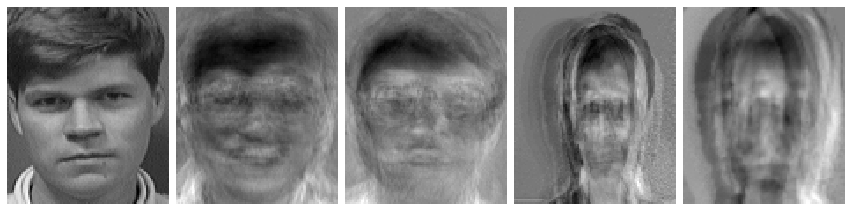

Propability criteria for given instance is reached: 1.0


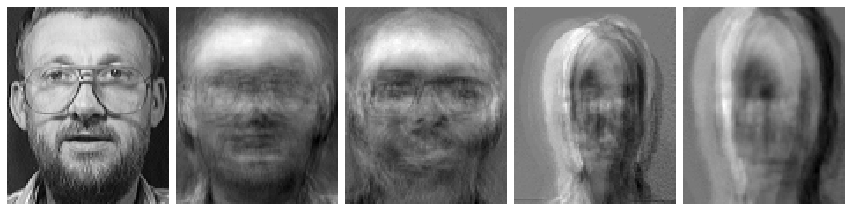

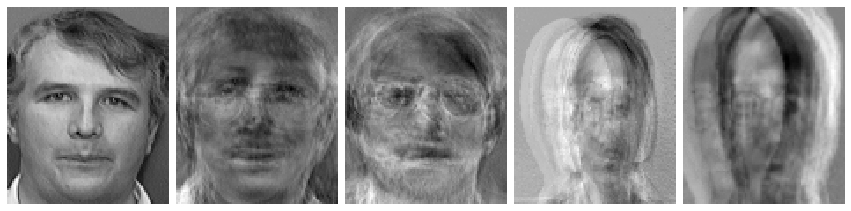

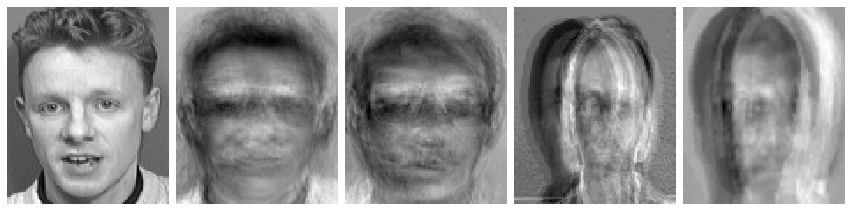

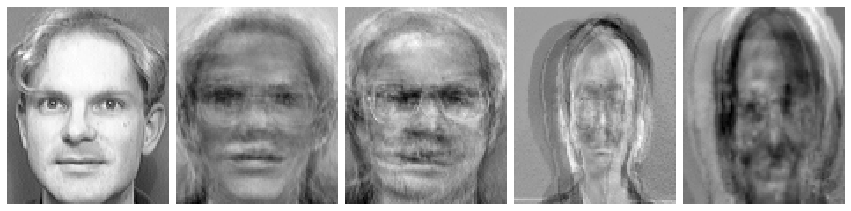

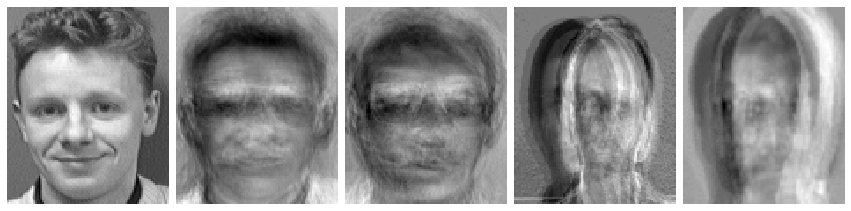

...

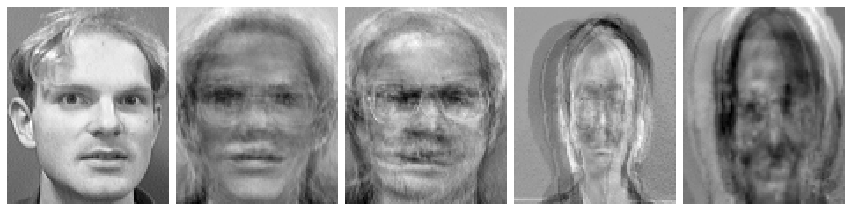

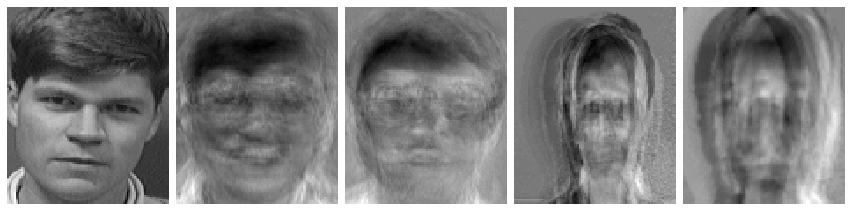

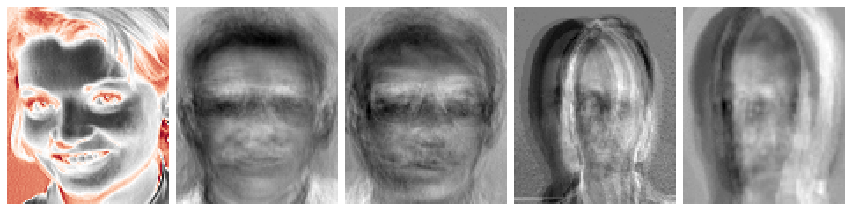

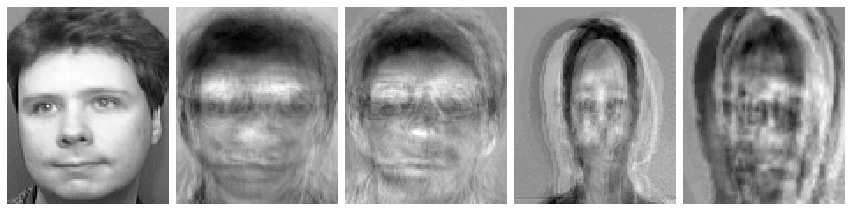

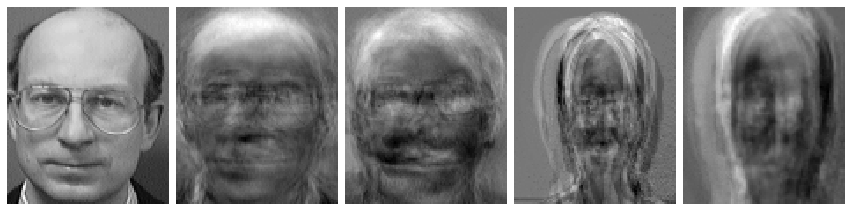

Propability criteria for given instance is reached: 1.0


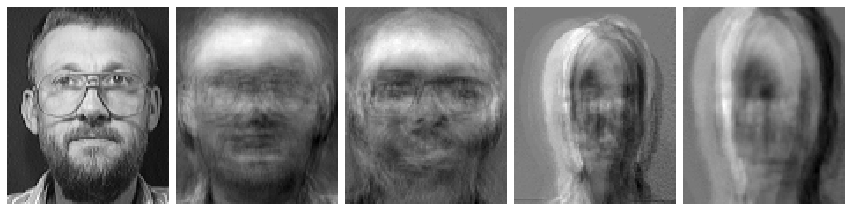

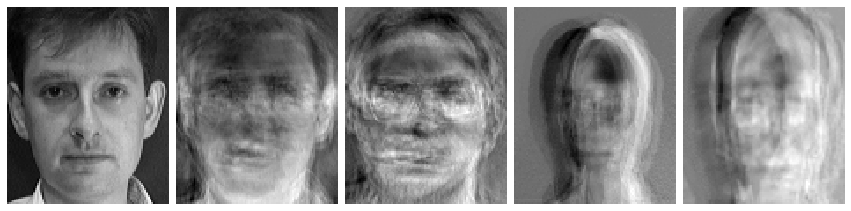

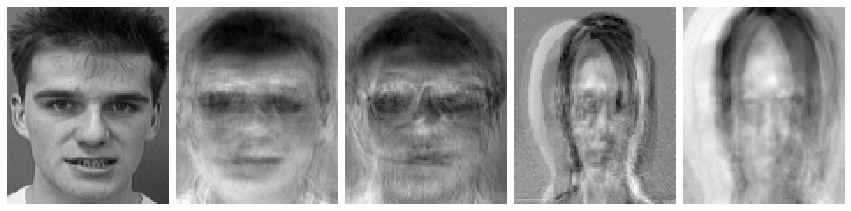

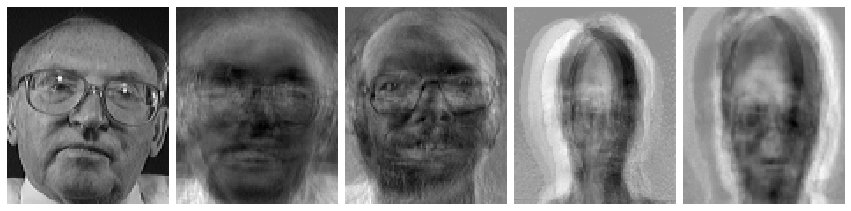

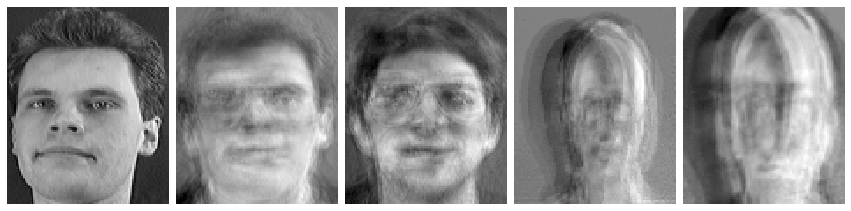

...

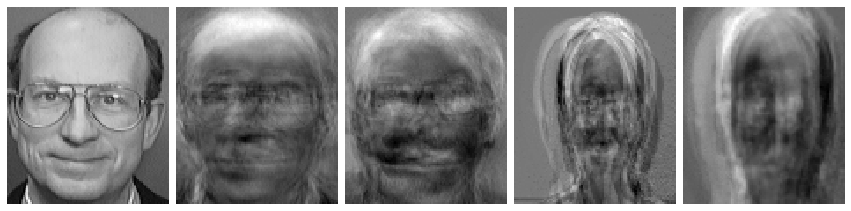

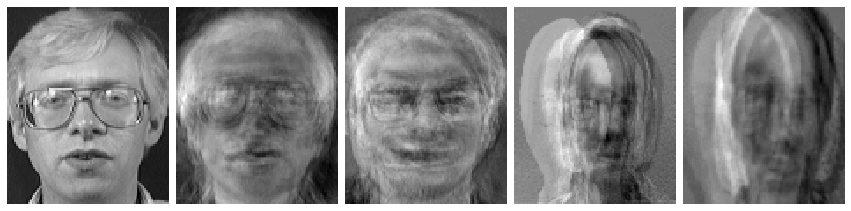

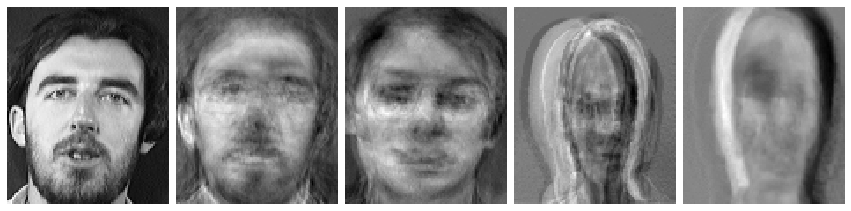

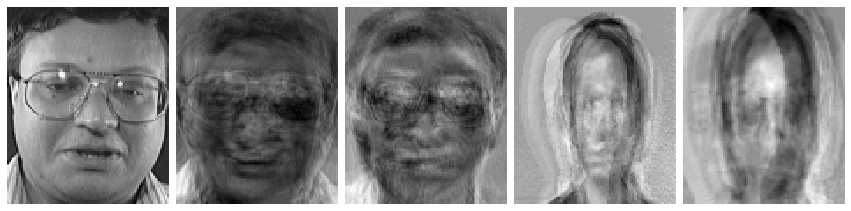

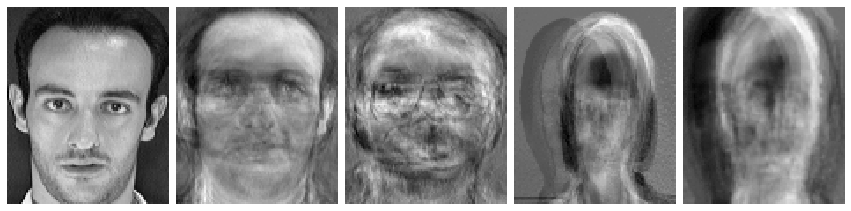

Propability criteria for given instance is reached: 1.0


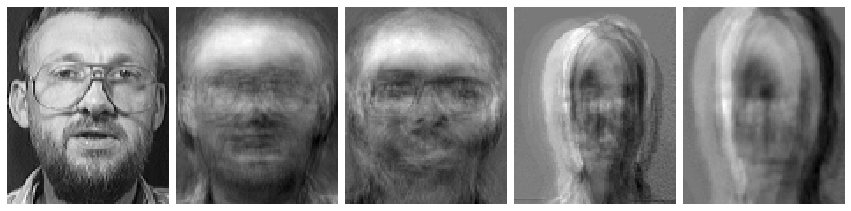

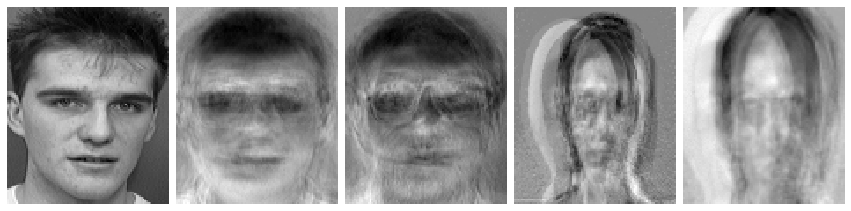

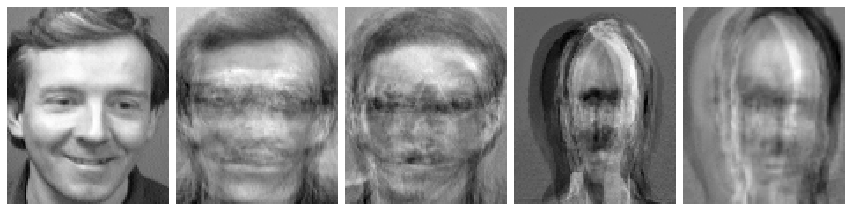

In [133]:
perform_inversion_multi_zca([zca_used_data_normalized, zca_unused_data_normalized, zca_other_data_normalized, zca_other_data_zoom_normalized], test_x_NN, test_y_NN)

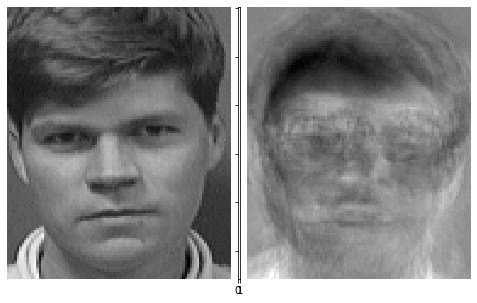

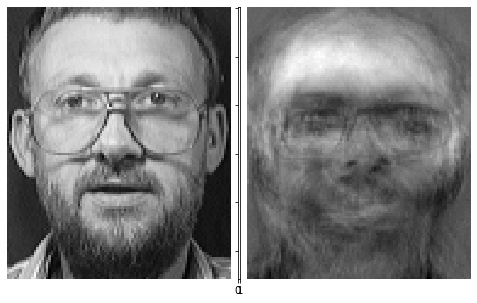

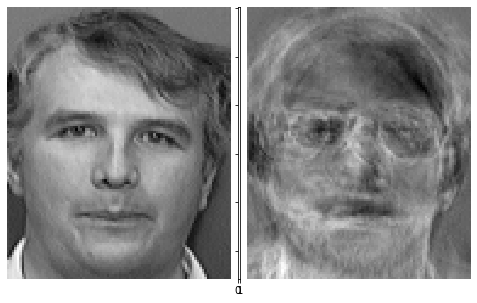

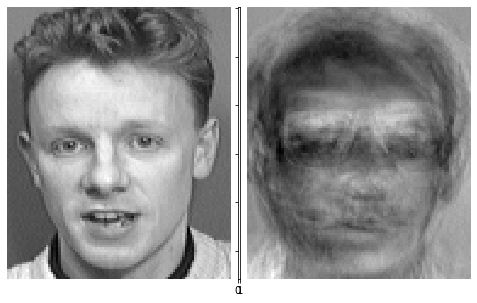

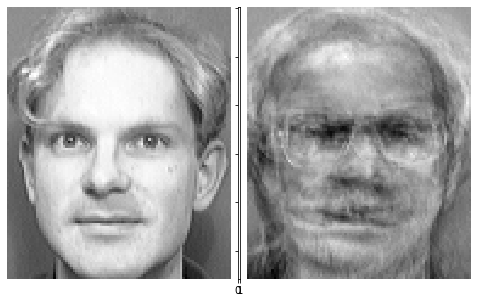

...

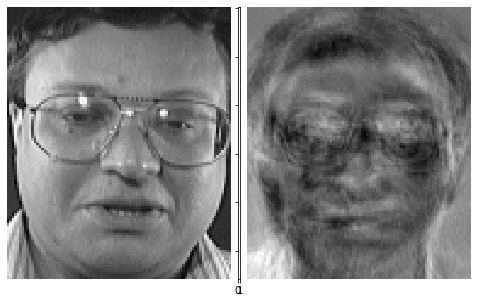

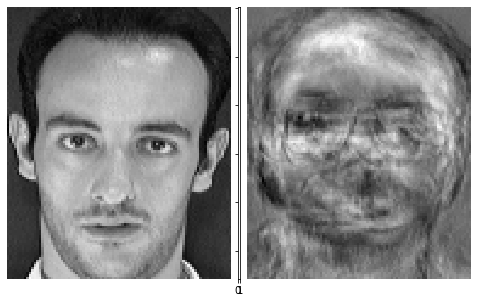

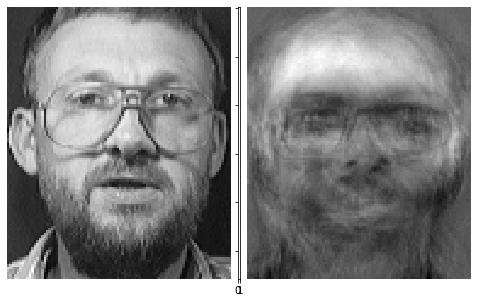

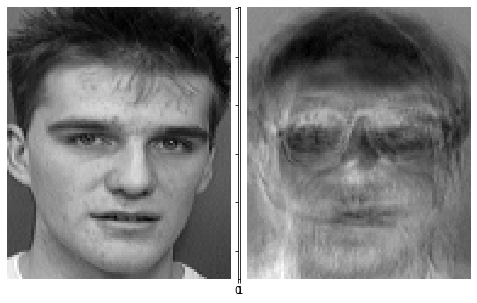

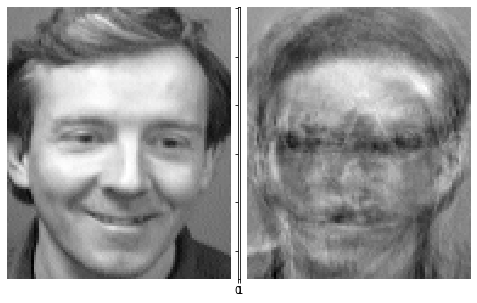

In [40]:
perform_inversion(zca_unused_data_normalized, test_x_NN, test_y_NN)

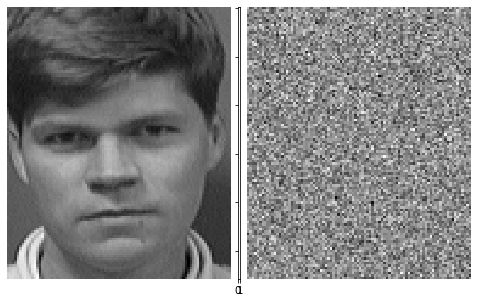

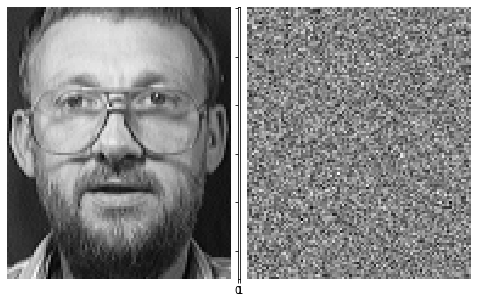

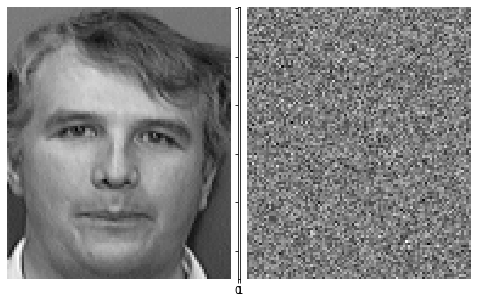

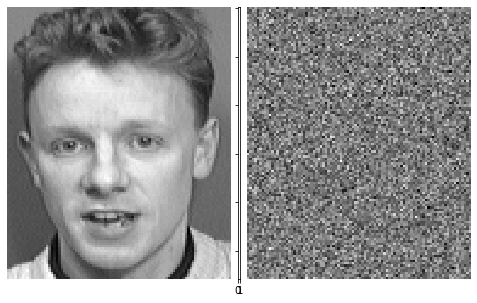

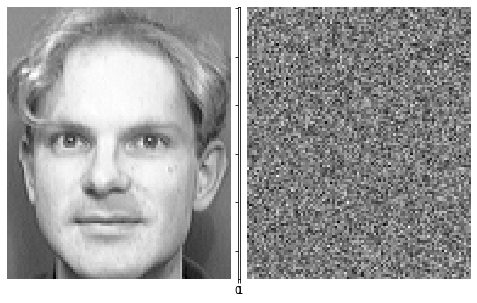

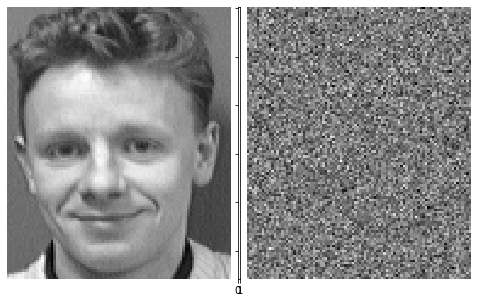

Propability criteria for given instance is reached: 1.0


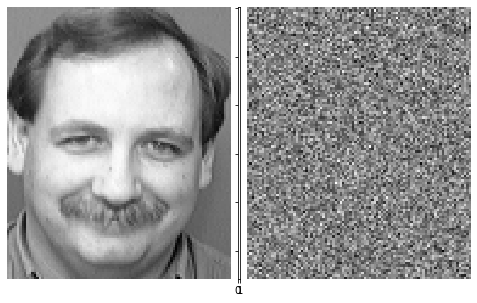

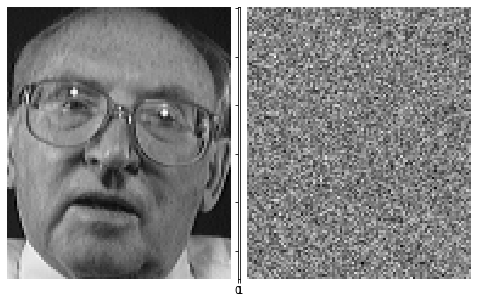

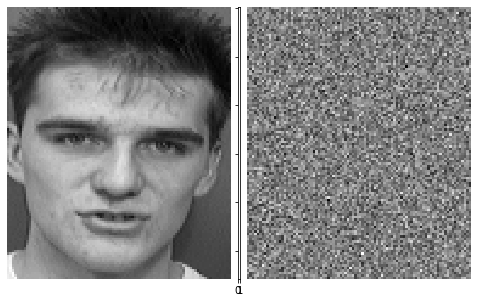

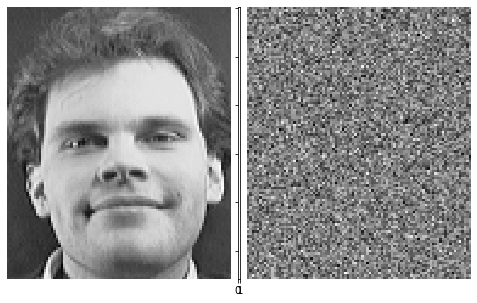

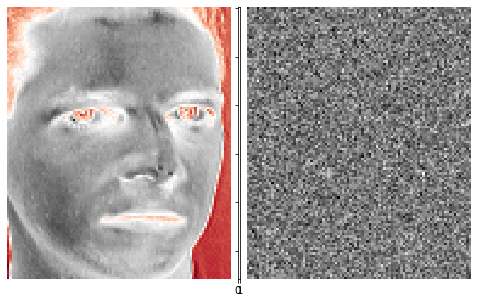

...

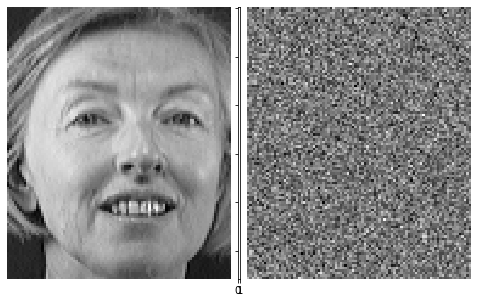

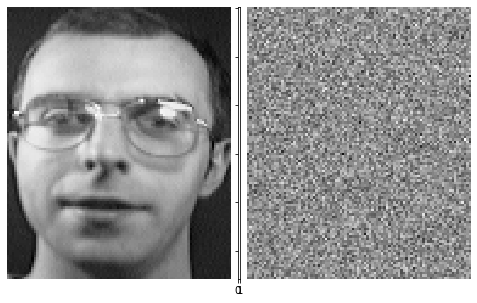

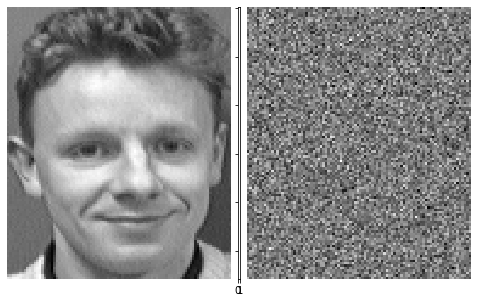

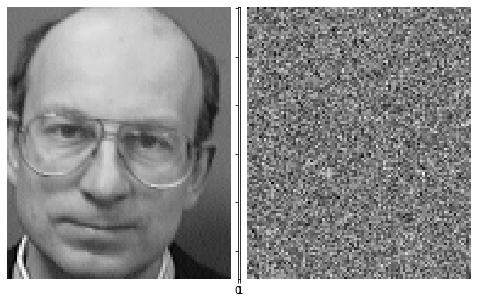

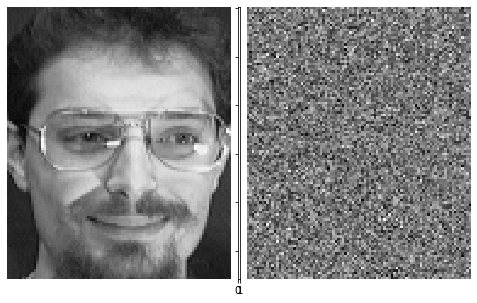

Propability criteria for given instance is reached: 1.0


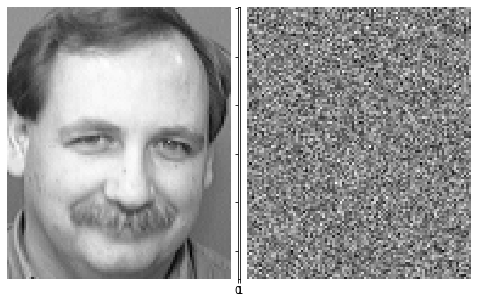

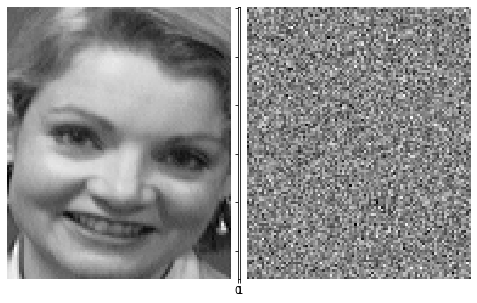

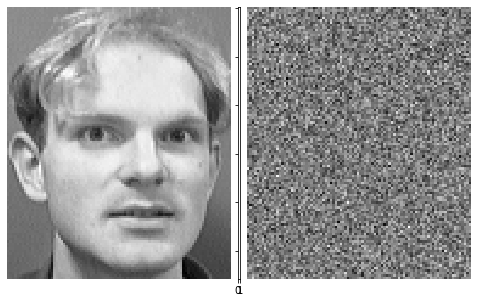

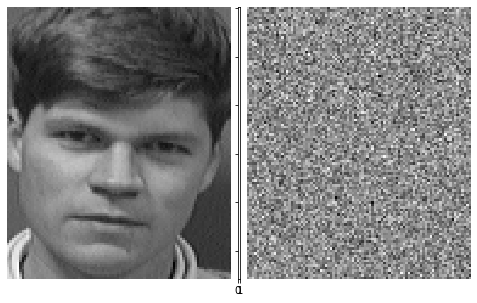

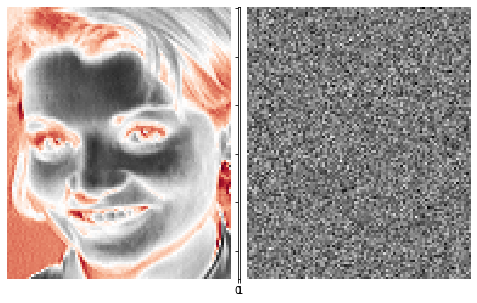

...

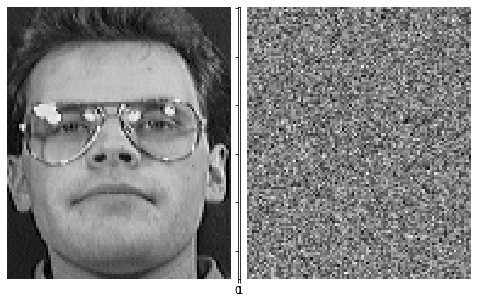

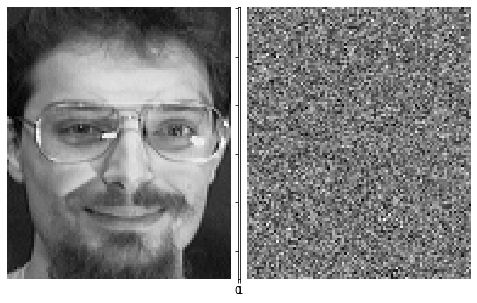

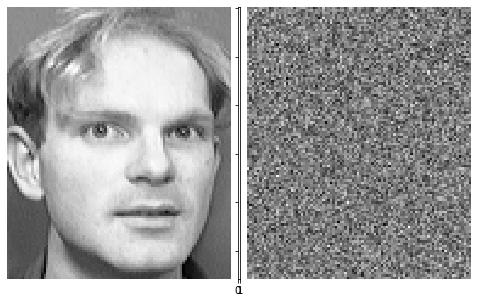

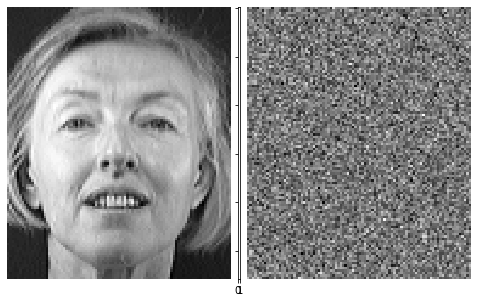

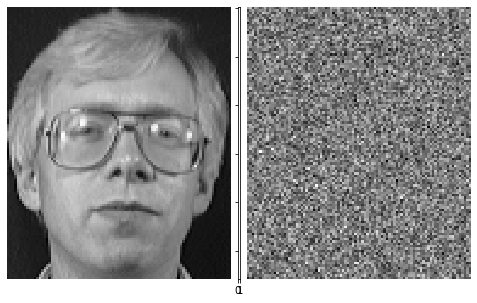

Propability criteria for given instance is reached: 1.0


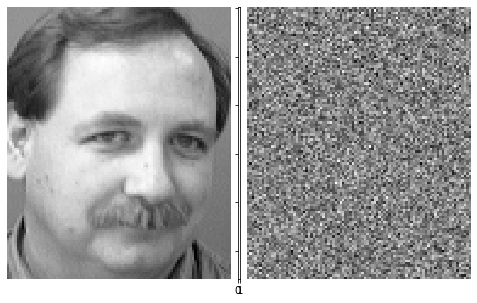

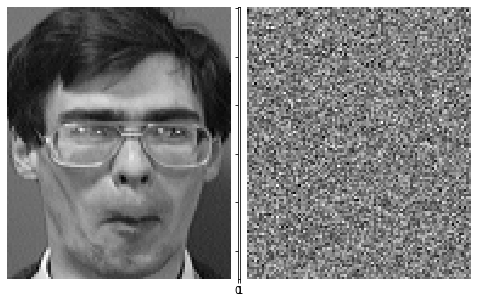

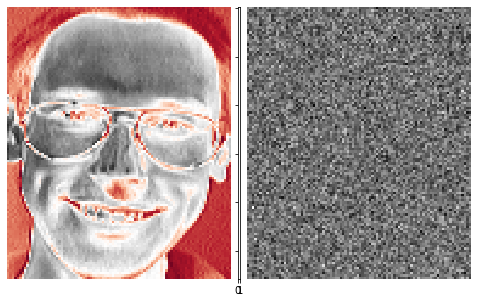

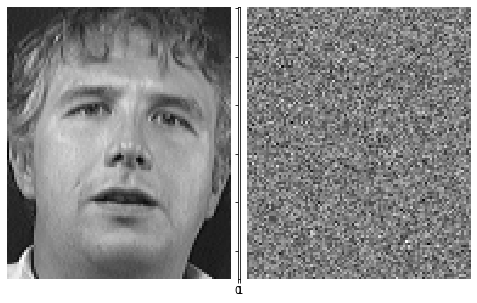

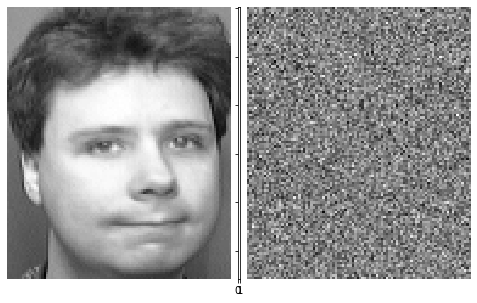

...

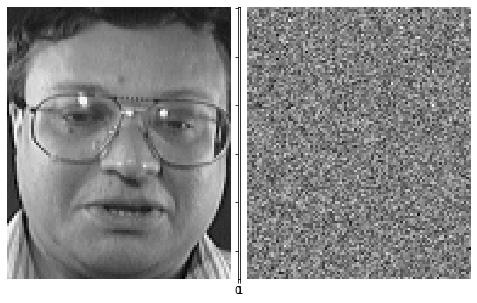

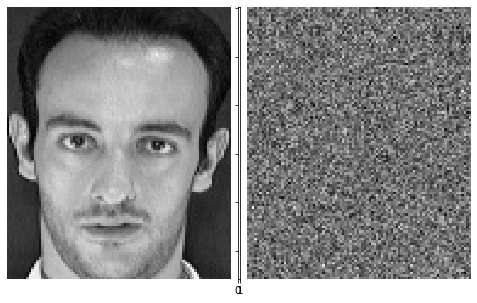

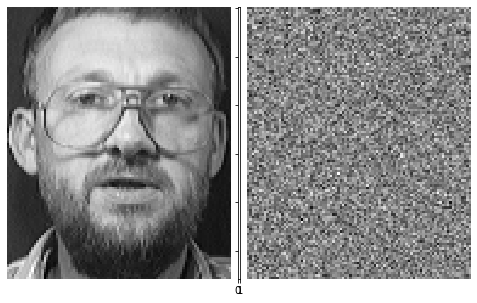

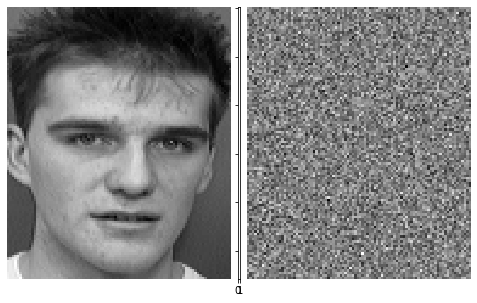

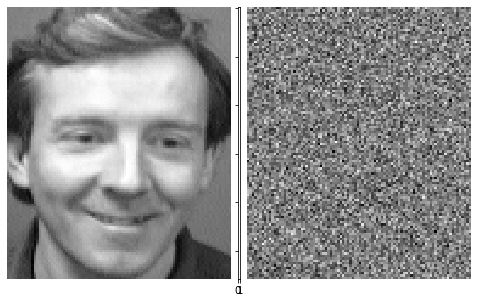

In [47]:
perform_inversion(zca_rand_data_normalized, test_x_NN, test_y_NN)

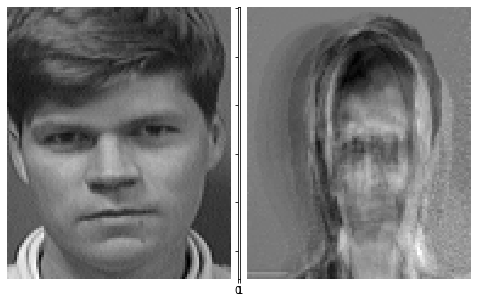

Propability criteria for given instance is reached: 1.0


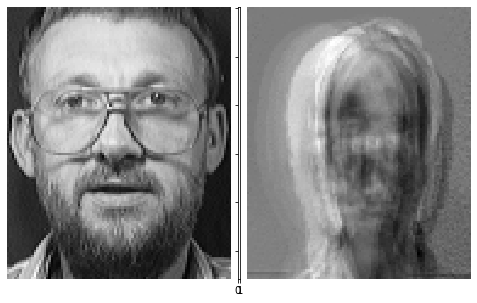

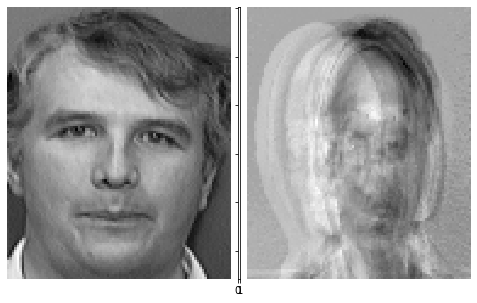

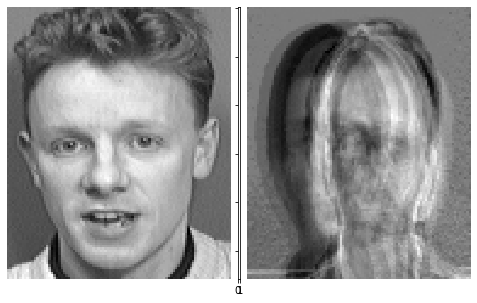

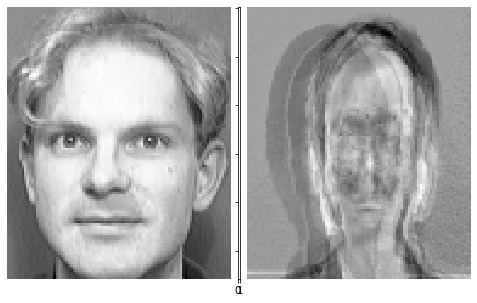

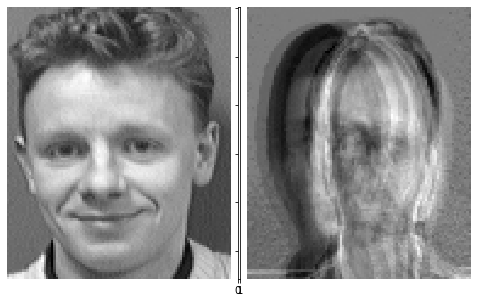

...

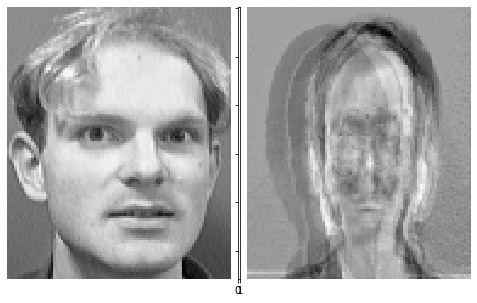

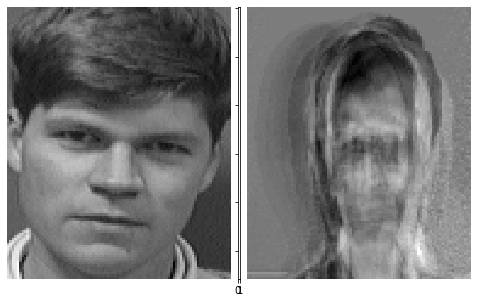

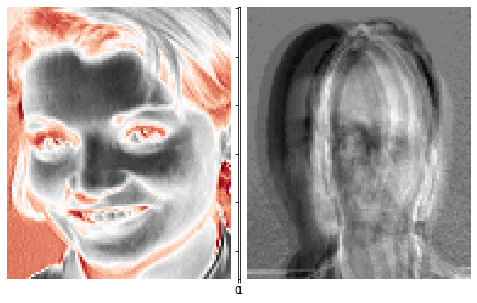

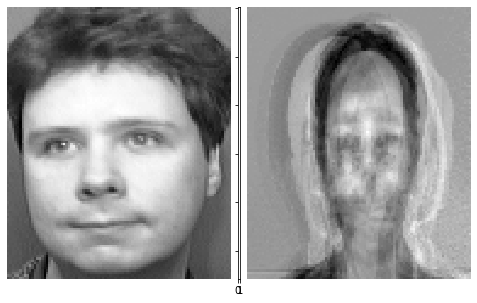

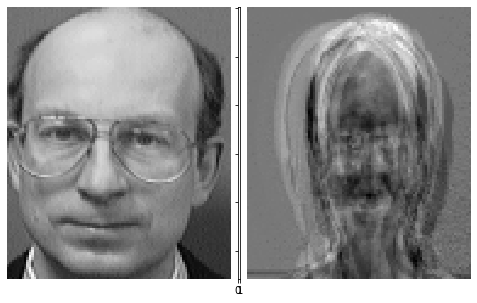

Propability criteria for given instance is reached: 1.0


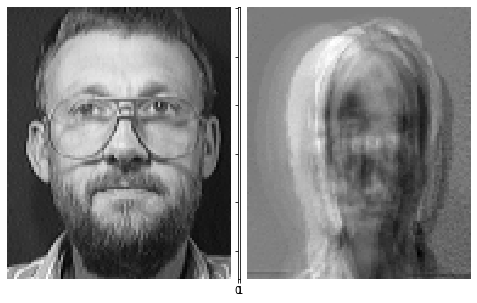

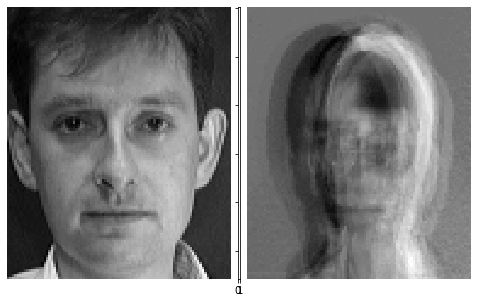

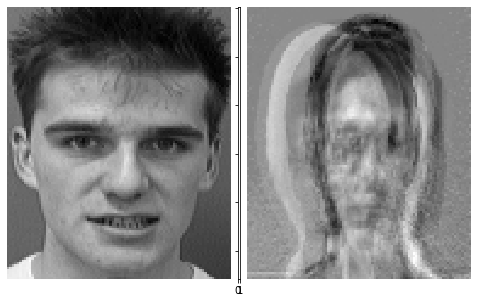

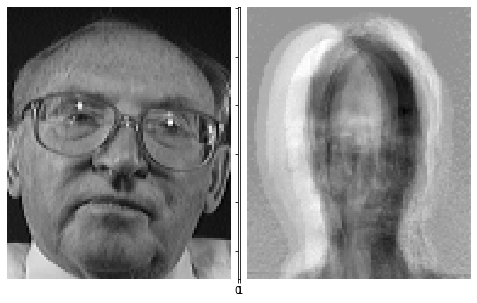

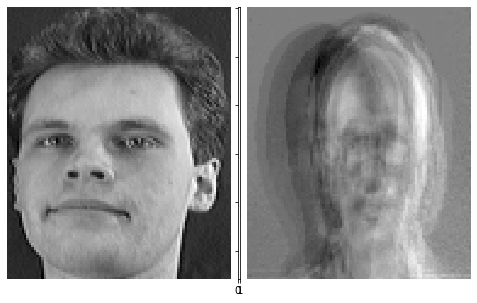

...

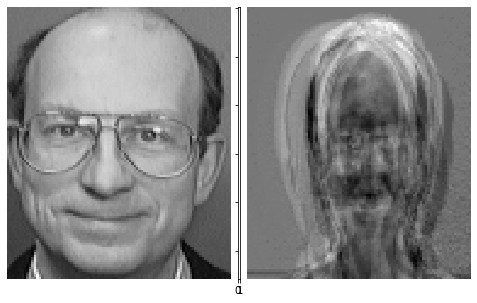

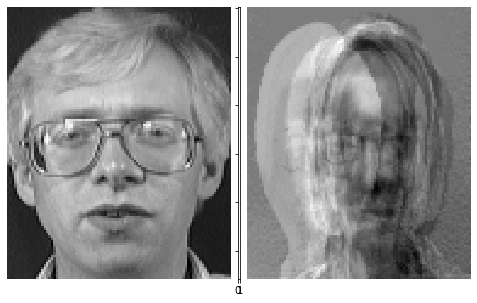

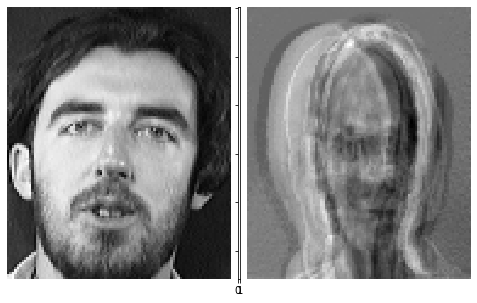

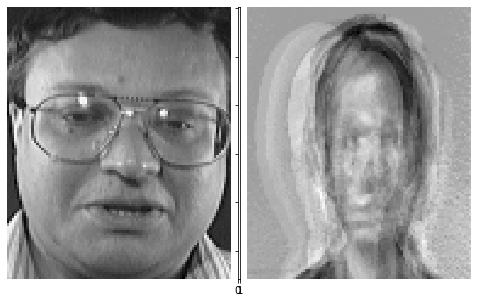

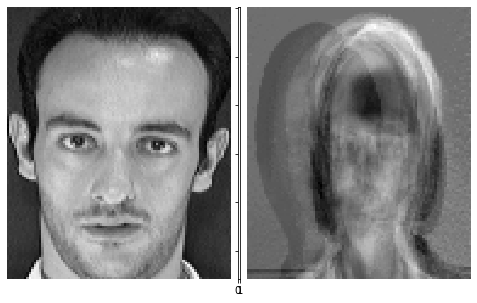

Propability criteria for given instance is reached: 1.0


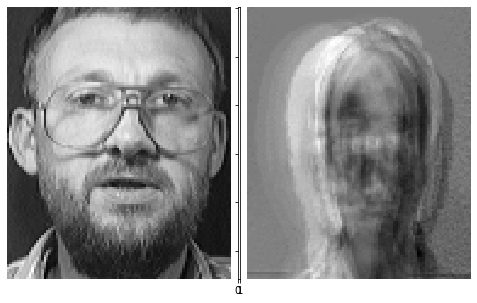

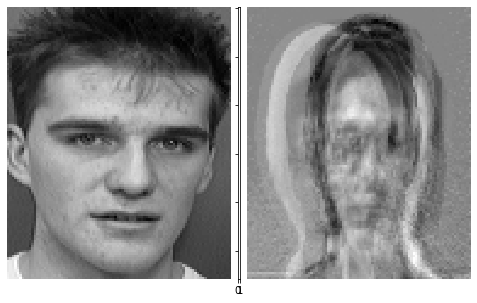

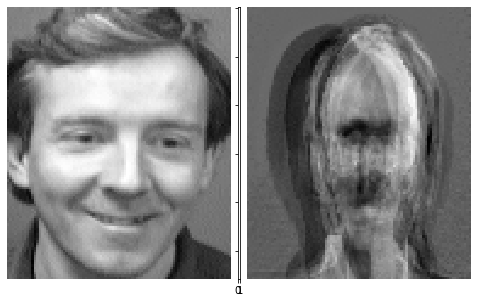

In [72]:
perform_inversion(zca_other_data_normalized, test_x_NN, test_y_NN)

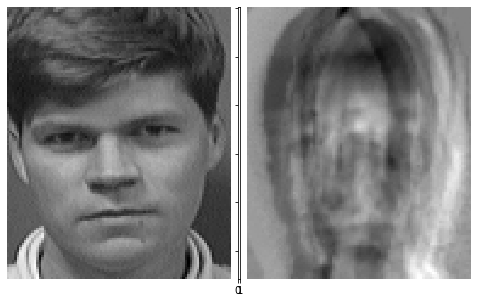

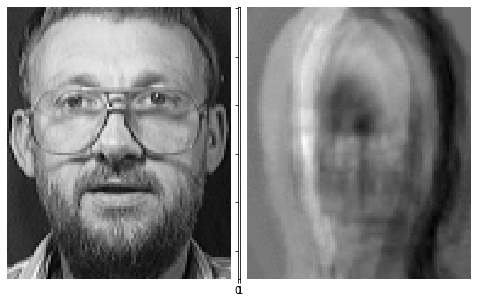

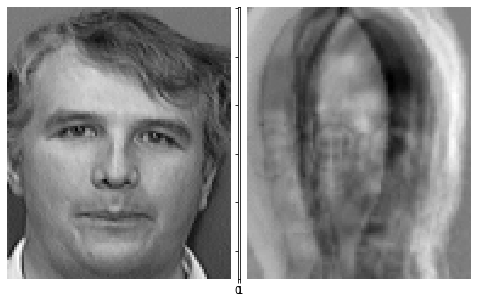

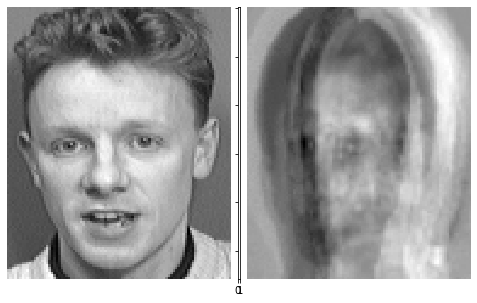

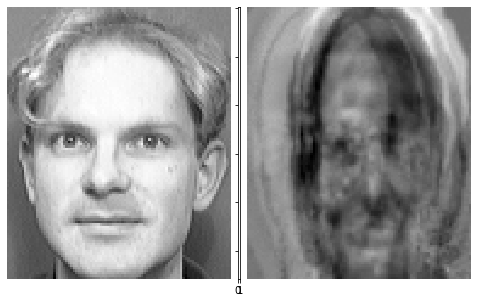

...

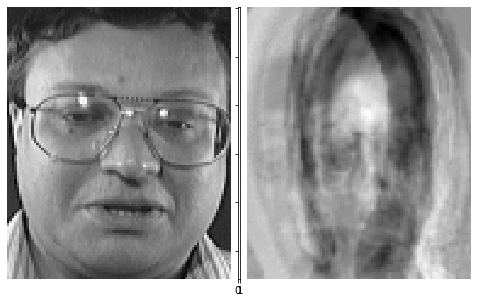

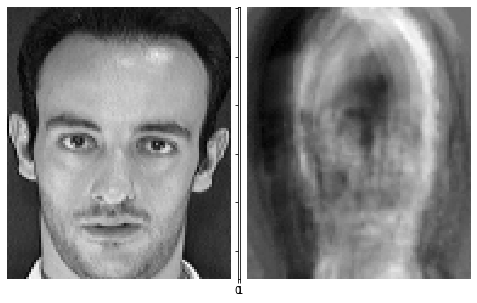

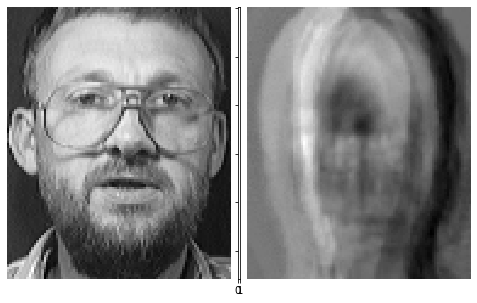

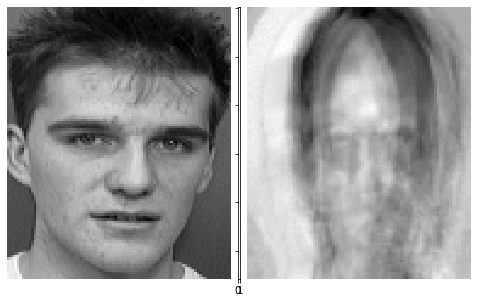

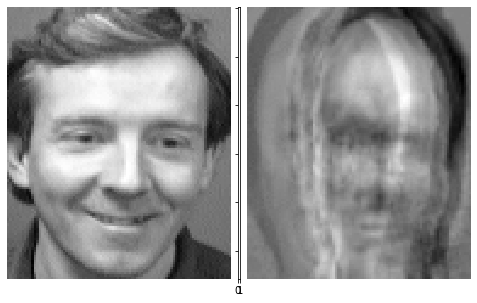

In [132]:
perform_inversion(zca_other_data_zoom_normalized, test_x_NN, test_y_NN)